## Shell Contact Example

In [1]:
# !pip install debugpy

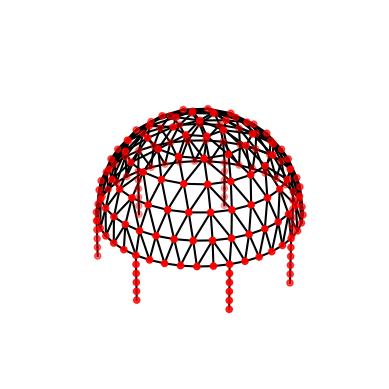

In [2]:
import numpy as np

import dismech


geom = dismech.GeomParams(rod_r0=0.005,
                          shell_h=0.005)

material = dismech.Material(density=1100,
                            youngs_rod=1e7,
                            youngs_shell=1e10,
                            poisson_rod=0.5,
                            poisson_shell=0.5)

shell_contact_sim = dismech.SimParams(static_sim=False,
                                  two_d_sim=False,   # no twisting
                                  use_mid_edge=False,
                                  use_line_search=True,
                                  show_floor=False,
                                  log_data=True,
                                  log_step=1,
                                  dt=1e-3,
                                  max_iter=100,
                                  total_time=3,
                                  plot_step=1,
                                  tol=1e-4,
                                  ftol=1e-4,
                                  dtol=1e-2)

env = dismech.Environment()
env.add_force('gravity', g=np.array([0.0, 0.0, 0])) # neutral bouyancy
env.add_force('damping', eta = 50)
env.add_force('hydrodynamics', rho=1000, cd=1)
env.add_force('thrust', thrust_coeff = 2000)

geo = dismech.Geometry.from_txt('input_full_jellyfish.txt')

robot = dismech.SoftRobot(geom, material, geo, shell_contact_sim, env)

In [3]:
log_node = np.array(np.where(
    robot.state.q[robot.node_dof_indices].reshape(-1, 3)[:, 2] >= 0.999)[0])

In [4]:
print("# nodes: ", np.shape(robot.nodes))
print("# faces: ", np.shape(robot.face_nodes_shell))

# nodes:  (179, 3)
# faces:  (245, 3)


### Time Stepping

As we are performing a static simulation, we must change gravity for each time step.

In [5]:
stepper = dismech.ImplicitEulerTimeStepper(robot)

In [6]:
from scipy.signal import sawtooth
import numpy as np

# One-time preprocessing function to compute tangential hinge mask
def compute_tangential_mask(robot, angle_threshold_deg=30):
    hinges = robot.hinge_springs.nodes_ind[:, 0:2]
    tangential_mask = np.zeros(len(hinges), dtype=bool)
    apex_z = np.max(robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)[:, 2]) # max height of the apex

    for i, (n1, n2) in enumerate(hinges):
        p1 = robot.state.q[robot.map_node_to_dof(n1)]
        p2 = robot.state.q[robot.map_node_to_dof(n2)]
        mid = 0.5 * (p1 + p2)
        r_mid = mid - [0,0,apex_z]

        hinge_vec = p2 - p1
        hinge_vec /= np.linalg.norm(hinge_vec)

        radial_vec = r_mid / np.linalg.norm(r_mid)

        angle_cos = np.dot(hinge_vec, radial_vec)
        angle_deg = np.degrees(np.arccos(np.clip(np.abs(angle_cos), -1.0, 1.0)))

        if angle_deg > (90 - angle_threshold_deg):
            tangential_mask[i] = True

    return tangential_mask



# Precompute tangential hinge mask ONCE
robot.tangential_hinge_mask = compute_tangential_mask(robot)

print("hinges:", robot.hinge_springs.nodes_ind[:, 0:2])
print("tangential hinges:",robot.tangential_hinge_mask )


# Modified actuation function
def actuate_jellyfish(robot, t):
    pulse_freq = 2                   # Hz
    pulse_amplitude = 3*np.pi/5   # radians
    theta_rest = 0.0

    T = 1.0 / pulse_freq
    s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))  # asymmetric contraction
    theta_base = theta_rest - pulse_amplitude * s

    n_hinges = robot.hinge_springs.inc_strain.shape[0]
    theta_bars = np.zeros(n_hinges)

    q_nodes = robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)
    apex_z = np.max(q_nodes[:, 2])
    radii = np.linalg.norm(q_nodes[:, :2], axis=1)
    base_radius = np.max(radii)

    for i in range(n_hinges):
        if not robot.tangential_hinge_mask[i]:
            continue  # skip non-tangential hinges

        n1, n2 = robot.hinge_springs.nodes_ind[i, 0:2]
        p1 = robot.state.q[robot.map_node_to_dof(n1)]
        p2 = robot.state.q[robot.map_node_to_dof(n2)]
        midpoint = 0.5 * (p1 + p2)

        r = np.linalg.norm(midpoint[:2]) / base_radius
        z = midpoint[2] / apex_z

        # traveling wave with delay based on height
        # phase_delay = 0.1 * z
        phase_delay = 0.15* (1 - z)
        theta = theta_rest - pulse_amplitude * 0.5 * (1 - sawtooth(2 * np.pi * (t - phase_delay) / T, width=0.3))

        # scale actuation by radial location
        # scale = 3 * r**2 - 2 * r**3
        scale = 0.3 + 0.7 * (3 * r**2 - 2 * r**3) # smoothstep function for scaling
        # scale = 1
        theta_bars[i] = theta * scale

    robot.hinge_springs.inc_strain = theta_bars
    return robot

# Assign the stepper callback
stepper.before_step = actuate_jellyfish


hinges: [[ 55  31]
 [ 53  54]
 [ 54  31]
 [ 31  32]
 [ 35  34]
 [ 60  35]
 [ 35  59]
 [ 90 129]
 [ 90  91]
 [ 60  59]
 [ 59  91]
 [ 55  54]
 [ 83  53]
 [ 53  82]
 [ 32  55]
 [ 88 126]
 [ 35  36]
 [ 18  17]
 [ 17  35]
 [ 35  18]
 [ 17   6]
 [ 15  32]
 [ 34  17]
 [ 17  16]
 [ 29  51]
 [ 79 116]
 [115  79]
 [114  79]
 [114  78]
 [ 78  79]
 [ 51  28]
 [ 50  79]
 [ 79  80]
 [ 50  80]
 [ 51  50]
 [108  73]
 [ 73  72]
 [107  73]
 [ 74 108]
 [ 97  98]
 [ 45  73]
 [ 73  74]
 [ 46  73]
 [ 46  74]
 [ 46  75]
 [ 48  26]
 [ 28  29]
 [ 29  13]
 [ 13  14]
 [ 14   4]
 [  4   3]
 [ 13   4]
 [ 28  13]
 [  1   8]
 [  1  21]
 [  9   1]
 [ 59  34]
 [ 90  59]
 [ 59  58]
 [ 91 129]
 [ 60  91]
 [ 92  91]
 [ 91 130]
 [130  92]
 [122  85]
 [ 54  83]
 [ 83  84]
 [ 85  54]
 [ 54  84]
 [ 84  85]
 [ 82  52]
 [ 81  82]
 [ 81  52]
 [ 52  51]
 [ 51  80]
 [ 81  51]
 [ 83  82]
 [120  83]
 [ 83 119]
 [ 82 118]
 [119  82]
 [ 53  31]
 [ 52  53]
 [ 53  30]
 [ 29  52]
 [ 52  30]
 [ 14  29]
 [ 29  30]
 [ 15  14]
 [ 14  30]
 [

In [7]:
# print(robot.hinge_springs.inc_strain.shape)
# print(geo.bend_twist_springs)

In [8]:
edge_elements = np.array([145, 150, 155, 160, 165, 170, 175])

# Step 1: Check each row in the bend_twist_springs array to see if the 3rd element is in the edge_elements.
# This creates a boolean mask for rows that match.
mask = np.isin(geo.bend_twist_springs[:,2], edge_elements)

# Step 2: Get the indices of rows that satisfy the condition.
row_indices = np.nonzero(mask)[0]

# print("Indices of rows with any edge elements:", row_indices)

# print("Bend-twist springs before modification:")
# print(robot.bend_springs.EI)
for i in row_indices:
    spring_i = robot.bend_springs.get_view(i)
    spring_i.EI = 1e8 * spring_i.EI

# print("Bend-twist springs after modification:")
# print(robot.bend_springs.EI)

In [9]:
robots = stepper.simulate()

qs = np.stack([robot.state.q for robot in robots])

iter: 1, error: 7229.817
iter: 2, error: 5310.230
iter: 3, error: 287.167
iter: 4, error: 3.524
current_time:  0.001
iter: 1, error: 3624.479
iter: 2, error: 24681.168
iter: 3, error: 109.727
iter: 4, error: 7.552
iter: 5, error: 0.346
current_time:  0.002
iter: 1, error: 3930.521
iter: 2, error: 34716.388
iter: 3, error: 307.539
iter: 4, error: 43.047
iter: 5, error: 2.203
current_time:  0.003
iter: 1, error: 4469.247
iter: 2, error: 28570.188
iter: 3, error: 159.889
iter: 4, error: 11.016
iter: 5, error: 1.377
current_time:  0.004
iter: 1, error: 4691.968
iter: 2, error: 23339.958
iter: 3, error: 106.609
iter: 4, error: 6.532
iter: 5, error: 0.984
current_time:  0.005
iter: 1, error: 4736.087
iter: 2, error: 19404.050
iter: 3, error: 95.684
iter: 4, error: 5.400
iter: 5, error: 0.841
current_time:  0.006
iter: 1, error: 4703.555
iter: 2, error: 16499.274
iter: 3, error: 93.622
iter: 4, error: 4.770
iter: 5, error: 0.768
current_time:  0.007
iter: 1, error: 4641.896
iter: 2, error: 15

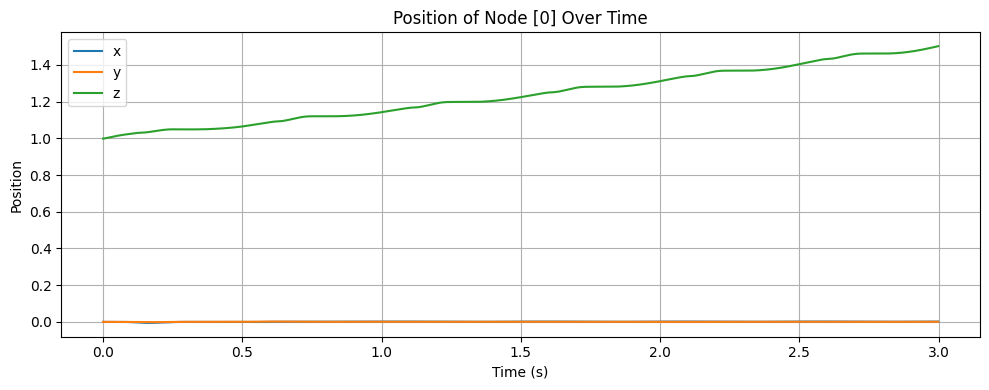

In [10]:
import matplotlib.pyplot as plt

# Extract the DOF indices (x, y, z) of the node you want to track
log_node_dofs = robot.map_node_to_dof(log_node)  # e.g., [ix, iy, iz]

# Extract position of that node across all timesteps
logged = qs[:, log_node_dofs].squeeze()  # shape (n_timesteps, 3)

# Plot x, y, z over time
t = np.arange(qs.shape[0]) * robot.sim_params.dt

plt.figure(figsize=(10, 4))
plt.plot(t, logged[:, 0], label='x')
plt.plot(t, logged[:, 1], label='y')
plt.plot(t, logged[:, 2], label='z')
plt.xlabel('Time (s)')
plt.ylabel('Position')
plt.title(f'Position of Node {log_node} Over Time')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# save logged data in xls file
import pandas as pd
df = pd.DataFrame({'Time (s)': t, 'X': logged[:, 0], 'Y': logged[:, 1], 'Z': logged[:, 2]})
df.to_excel('jellyfish_node_position.xlsx', index=False)


In [11]:
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)
options = dismech.AnimationOptions(title='Shell contact p2p', plot_step=10)

fig = dismech.get_interactive_animation_plotly(robot, t, qs, options)
fig.show()

301


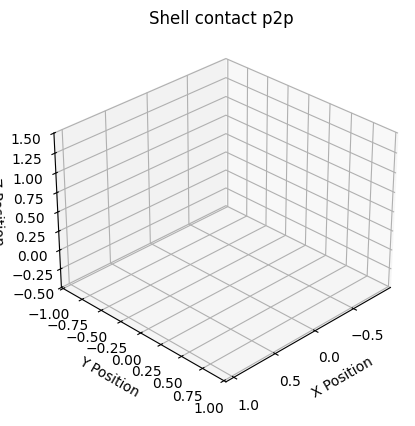

In [12]:
ani = dismech.get_animation(robot, t, qs, options)
ani.save('jellyfish.gif')

In [13]:
from src.dismech.logging import logDataForRendering
print(np.shape(t.reshape(-1, 1)), np.shape(qs))
rod_data, shell_data = logDataForRendering(qs, t.reshape(-1, 1), robot, len(t), robot.sim_params.static_sim, robot.map_node_to_dof)


(3000, 1) (3000, 613)
(3000, 614) (3000, 1) (3000, 613)
(245, 3)
245


In [14]:
from src.dismech.logging import export_rod_shell_data
export_rod_shell_data(robot, rod_file='rawDataRod.txt', shell_file='rawDataShell.txt',
                          rod_js='rodData.js', shell_js='shellData.js',
                          rod_radius=0.1, scaleFactor=100)

In [15]:
import numpy as np

def export_parachute_data(dof_with_time, elStretchRod, MultiRod,
                          shell_file='rawDataShell.txt',
                          rod_js='rodData.js', shell_js='shellData.js',
                          scaleFactor=10, rod_radius=0.32):
    """
    Export rod + shell data for parachute visualization into JS files.

    Parameters
    ----------
    dof_with_time : np.ndarray
        DOF with time array (shape: (3*n_nodes+1, steps)).
    elStretchRod : np.ndarray
        Rod element connectivity matrix.
    MultiRod : object
        Object with attributes: n_nodes, n_rod_nodes, n_faces.
    shell_file : str
        Path to raw shell node data (.txt).
    rod_js : str
        Output JS file path for rod data.
    shell_js : str
        Output JS file path for shell data.
    scaleFactor : float
        Factor to scale node coordinates.
    rod_radius : float
        Radius of rod.
    """

    # === Rod data ===
    node_data = scaleFactor * dof_with_time[:, 0:3*MultiRod.n_nodes]
    # connectivity_matrix = elStretchRod - np.ones_like(elStretchRod, dtype=int)
    connectivity_matrix = elStretchRod
    n_Tri = MultiRod.face_nodes_shell.shape[0]

    with open(rod_js, 'w') as f:
        f.write('var rodData = {\n')
        # Uncomment if you want to include:
        # f.write(f'  nNodes : {MultiRod.n_rod_nodes},\n')
        # f.write(f'  rodRadius : {rod_radius},\n')

        # Node positions
        f.write('  nodePositions : [\n')
        for row in node_data:
            row_str = ', '.join(map(str, row))
            f.write(f'    [{row_str}],\n')
        f.write('  ],\n')

        # Connectivity
        f.write('  connectivity : [\n')
        for row in connectivity_matrix:
            row_str = ', '.join(map(str, row))
            f.write(f'    [{row_str}],\n')
        f.write('  ]\n')

        f.write('};\n')

    # === Shell data ===
    ds = np.loadtxt(shell_file)

    with open(shell_js, 'w') as f:
        f.write('var shellData = {\n')
        f.write(f'  nTri : {n_Tri},\n')
        f.write('  nodes : [\n')
        for row in ds:
            x, y, z = row * scaleFactor
            f.write(f'    {x}, {y}, {z},\n')
        f.write('  ]\n')
        f.write('};\n')


In [16]:
export_parachute_data(qs, np.concatenate((geo.rod_edges, geo.rod_shell_joint_edges), axis=0), robot,
                          rod_js='rodData.js',
                          scaleFactor=10)

In [17]:
print(robot.rod_edges)

[[144 145]
 [145 146]
 [146 147]
 [147 148]
 [149 150]
 [150 151]
 [151 152]
 [152 153]
 [154 155]
 [155 156]
 [156 157]
 [157 158]
 [159 160]
 [160 161]
 [161 162]
 [162 163]
 [164 165]
 [165 166]
 [166 167]
 [167 168]
 [169 170]
 [170 171]
 [171 172]
 [172 173]
 [174 175]
 [175 176]
 [176 177]
 [177 178]]


In [18]:
print(geo.rod_edges)
print(geo.rod_shell_joint_edges)

[[144 145]
 [145 146]
 [146 147]
 [147 148]
 [149 150]
 [150 151]
 [151 152]
 [152 153]
 [154 155]
 [155 156]
 [156 157]
 [157 158]
 [159 160]
 [160 161]
 [161 162]
 [162 163]
 [164 165]
 [165 166]
 [166 167]
 [167 168]
 [169 170]
 [170 171]
 [171 172]
 [172 173]
 [174 175]
 [175 176]
 [176 177]
 [177 178]]
[[144 103]
 [149 109]
 [154 115]
 [159 121]
 [164 127]
 [169 133]
 [174 139]]
